# Assessing Migratory Performance in Collision-Surviving Birds With Motus

This notebook analyzes migratory bird data from the Motus Wildlife Tracking System, specifically focusing on the Motus Northeast Collision Project. The project tracked six species that survived window collisions in the Lake Erie region (Cleveland and Pittsburgh) during 2018:

- American Woodcock
- White-throated Sparrow  
- Gray Catbird
- Ovenbird
- Wood Thrush
- Magnolia Warbler

### Background
Window collisions pose a severe threat to migratory bird populations, estimated to kill up to one billion birds annually. This research examines birds that survived collisions and were rehabilitated before being released with Motus nanotags for tracking.

### Research Focus
The analysis assesses migratory performance of collision-surviving birds by examining:
- Detection probabilities
- Migration patterns
- Travel speeds and distances
- Comparative analysis between rehabilitated and wild birds

### Data Source
Data comes from the [Motus Wildlife Tracking System](https://motus.org/) (specifically the [Northeast Collision Project](https://www.northeastmotus.com/)), which uses automated radio-telemetry technology to track tagged birds with high geospatial accuracy.

The complete research paper can be found [here](https://drive.google.com/file/d/1XWS2oeSzWKw9krQqV-sD-tiwlvycEEAM/view?usp=sharing).

# Analysis Questions

## 1. Population Demographics
- What is the distribution of rehab vs non-rehab birds?
    - Total counts by status
    - Breakdown by species
    - Detection frequencies
    - Repeat detections analysis (birds detected multiple times)

## 2. Spatial Analysis
- What are the movement patterns?
    - Geographic distribution of detections
    - Range/territory size analysis
    - Movement corridors identification

Initial import of Python libraries

In [1]:
import os
import gdown
import tempfile
from matplotlib import pyplot as plt
import pandas as pd
import folium
import movingpandas as mpd

from dotenv import load_dotenv
from datetime import datetime
from folium import plugins
from IPython.display import display, HTML, IFrame

/Users/km7yh/miniconda3/envs/gis_dev/lib/python3.11/site-packages/movingpandas/__init__.py:37: UserWarning: Missing optional dependencies. To use the trajectory smoother classes please install Stone Soup (see https://stonesoup.readthedocs.io/en/latest/#installation).
  warnings.warn(e.msg, UserWarning)


# Helper Functions

In [2]:
def load_gdrive_csv(file_id):
    """
    Load a CSV file from Google Drive directly into a pandas DataFrame.
    Uses Mac Roman encoding.
    
    Args:
        file_id (str): The Google Drive file ID
        
    Returns:
        pd.DataFrame: The loaded DataFrame
        
    Raises:
        ValueError: If file_id is None or empty
        Exception: If there's an error downloading or loading the file
    """
    if not file_id:
        raise ValueError("file_id cannot be None or empty")
    
    # Create URL for direct download
    url = f'https://drive.google.com/uc?id={file_id}'
    
    try:
        # Create a temporary file
        with tempfile.NamedTemporaryFile(suffix='.csv', delete=False) as temp_file:
            # Download to temporary file
            gdown.download(url, temp_file.name, quiet=True)
            
            try:
                # Read the CSV with Mac Roman encoding
                df = pd.read_csv(temp_file.name, encoding='mac_roman', low_memory=False)
                print("Successfully loaded with mac_roman encoding")
            except Exception as e:
                print(f"Error with mac_roman encoding: {e}")
                raise
            
            # Clean up the temporary file
            os.unlink(temp_file.name)
            
            return df
            
    except Exception as e:
        raise Exception(f"Error loading data: {e}")

In [3]:
def create_and_display_species_maps(df):
    """
    Create and display separate maps for each species using Folium, with species images.
    
    Args:
        df (pd.DataFrame): The dataframe containing detection data.
    """
    # Dictionary mapping species to image URLs and their sources
    species_images = {
        "American Woodcock": {
            "url": "https://s3.animalia.bio/animals/photos/full/1.25x1/american-woodcock-7.webp?id=2695a062c42e7be1d2c7b03c930ca04d",
            "source": "Animalia.bio"
        },
        "White-throated Sparrow": {
            "url": "https://s3.animalia.bio/animals/photos/full/1.25x1/2560px-white-throated-sparrow-28zonotrichia-albicollis29-282249262111029.webp?id=e13c663aadda28825a384b32374465b6",
            "source": "Animalia.bio"
        },
        "Gray Catbird": {
            "url": "https://upload.wikimedia.org/wikipedia/commons/9/91/Gray_catbird_%2885315%29.jpg",
            "source": "Wikimedia Commons"
        },
        "Ovenbird": {
            "url": "https://upload.wikimedia.org/wikipedia/commons/thumb/3/3c/Ovenbird_%2890497%29.jpg/1599px-Ovenbird_%2890497%29.jpg?20220930160445",
            "source": "Wikimedia Commons"
        },
        "Wood Thrush": {
            "url": "https://s3.animalia.bio/animals/photos/full/1.25x1/very-unhappy-veery.webp?id=d41560a80cdb0902ecd76d30899b9804",
            "source": "Animalia.bio"
        },
        "Magnolia Warbler": {
            "url": "https://s3.animalia.bio/animals/photos/full/1.25x1/2560px-magnolia-warbler-281589849837429.webp?id=e8d48ffc043eb2cacd89d0e35d812600",
            "source": "Animalia.bio"
        }
    }

    # Get unique species
    species_list = df['speciesEN.x'].unique()
    
    # Collect all unique sources
    sources = set(info["source"] for info in species_images.values())
    source_message = "Image sources: " + ", ".join(sources)
    
    # Process each species
    for species in species_list:
        print(f"\n{species}")
        
        # Display bird image
        if species in species_images:
            display(HTML(f"""
                <div style="margin-bottom: 10px;">
                    <img src="{species_images[species]['url']}" 
                         alt="{species}" 
                         style="width: 300px; height: 200px; object-fit: cover;">
                    <p><i>{source_message}</i></p>
                </div>
            """))
        
        # Create new map for this species
        m = folium.Map(location=[42, -81], zoom_start=6)
        
        # Get data for this species
        species_data = df[df['speciesEN.x'] == species]
        
        # Add trajectories
        for tag_id in species_data.motusTagID.unique():
            bird_data = species_data[species_data.motusTagID == tag_id].sort_values('ts.h')
            
            if len(bird_data) > 1:
                # Determine color based on rehab status
                color = '#FF6B6B' if bird_data['rehab'].iloc[0] == 'Y' else '#4D96FF'  # Distinct red and blue
                status = 'Rehab' if bird_data['rehab'].iloc[0] == 'Y' else 'Wild'
                
                # Create points list
                points = list(zip(bird_data.recvLat, bird_data.recvLon))
                
                # Add trajectory line
                popup_text = f"""
                <b>Tag ID:</b> {tag_id}<br>
                <b>Status:</b> {status}<br>
                <b>Detections:</b> {len(bird_data)}
                """
                
                folium.PolyLine(
                    points,
                    weight=3,
                    color=color,
                    opacity=0.8,
                    popup=popup_text
                ).add_to(m)
                
                # Add start/end markers
                folium.CircleMarker(
                    points[0],
                    radius=6,
                    color='#2ECC71',  # Distinct green
                    fill=True,
                    popup=f"Start: Tag {tag_id}",
                    tooltip=f"Start: {tag_id}"
                ).add_to(m)
                
                folium.CircleMarker(
                    points[-1],
                    radius=6,
                    color='#9B59B6',  # Distinct purple
                    fill=True,
                    popup=f"End: Tag {tag_id}",
                    tooltip=f"End: {tag_id}"
                ).add_to(m)
        
        # Create custom legend with line examples
        legend_html = '''
        <div style="position: fixed; bottom: 50px; left: 50px; z-index: 1000; 
                    background-color: white; padding: 10px; border: 2px solid grey;">
            <p><strong>Legend</strong></p>
            <div style="margin-bottom: 5px;">
                <div style="display: inline-block; width: 30px; height: 3px; background-color: #FF6B6B; vertical-align: middle;"></div>
                <span style="margin-left: 5px;">Rehab Bird Path</span>
            </div>
            <div style="margin-bottom: 5px;">
                <div style="display: inline-block; width: 30px; height: 3px; background-color: #4D96FF; vertical-align: middle;"></div>
                <span style="margin-left: 5px;">Wild Bird Path</span>
            </div>
            <div style="margin-bottom: 5px;">
                <span style="color: #2ECC71;">●</span>
                <span style="margin-left: 5px;">Starting Location</span>
            </div>
            <div>
                <span style="color: #9B59B6;">●</span>
                <span style="margin-left: 5px;">Ending Location</span>
            </div>
        </div>
        '''
        m.get_root().html.add_child(folium.Element(legend_html))
        
        display(m)

In [4]:
def plot_animated_trajectories_folium(trajectories, center=[42, -81], display_in_notebook=True):
    """
    Plot animated trajectories using Folium with improved legend.

    Args:
        trajectories (mpd.TrajectoryCollection): The trajectory collection
        center (list): The center coordinates of the map
        display_in_notebook (bool): Whether to display the map in the notebook
    """
    # Create base map
    m = folium.Map(location=center, zoom_start=6)
    
    # Prepare features for TimestampedGeoJson
    features = []
    
    # Process each trajectory
    for traj in trajectories:
        # Get trajectory points dataframe
        points_df = traj.df
        
        if len(points_df) > 1:
            # Get bird info
            species = points_df['speciesEN.x'].iloc[0]
            status = 'Rehab' if points_df['rehab'].iloc[0] == 'Y' else 'Wild'
            color = '#FF6B6B' if points_df['rehab'].iloc[0] == 'Y' else '#4D96FF'  # Distinct red and blue
            
            # Add trajectory line (permanent)
            coordinates = [[y, x] for x, y in zip(points_df.geometry.x, points_df.geometry.y)]
            
            popup_text = f"""
            <div style="min-width: 200px">
                <h4>Bird Details</h4>
                <b>Tag ID:</b> {traj.id}<br>
                <b>Species:</b> {species}<br>
                <b>Status:</b> {status}<br>
                <b>Detections:</b> {len(points_df)}
            </div>
            """
            
            folium.PolyLine(
                coordinates,
                weight=3,
                color=color,
                opacity=0.8,
                popup=folium.Popup(popup_text, max_width=300)
            ).add_to(m)
            
            # Create animated point features
            for idx, row in points_df.iterrows():
                point_feature = {
                    'type': 'Feature',
                    'geometry': {
                        'type': 'Point',
                        'coordinates': [row.geometry.x, row.geometry.y]
                    },
                    'properties': {
                        'time': idx.strftime('%Y-%m-%d %H:%M:%S'),
                        'popup': f"""
                        <div style="min-width: 180px">
                            <b>Tag:</b> {traj.id}<br>
                            <b>Species:</b> {species}<br>
                            <b>Status:</b> {status}<br>
                            <b>Time:</b> {idx.strftime('%Y-%m-%d %H:%M')}
                        </div>
                        """,
                        'icon': 'circle',
                        'iconstyle': {
                            'fillColor': color,
                            'fillOpacity': 0.8,
                            'stroke': 'true',
                            'radius': 6
                        }
                    }
                }
                features.append(point_feature)
                
                # Add start and end markers
                if idx == points_df.index[0]:  # Start point
                    folium.CircleMarker(
                        [row.geometry.y, row.geometry.x],
                        radius=8,
                        color='#2ECC71',  # Distinct green
                        fill=True,
                        popup=f'Start: Tag {traj.id} ({species})'
                    ).add_to(m)
                elif idx == points_df.index[-1]:  # End point
                    folium.CircleMarker(
                        [row.geometry.y, row.geometry.x],
                        radius=8,
                        color='#9B59B6',  # Distinct purple
                        fill=True,
                        popup=f'End: Tag {traj.id} ({species})'
                    ).add_to(m)
    
    # Add TimestampedGeoJson layer
    plugins.TimestampedGeoJson(
        {'type': 'FeatureCollection', 'features': features},
        period='PT1H',
        add_last_point=True,
        auto_play=True,
        loop=True,
        max_speed=5,
        loop_button=True,
        date_options='YYYY-MM-DD HH:mm:ss',
        time_slider_drag_update=True
    ).add_to(m)
    
    # Add improved legend with toggle functionality
    legend_html = '''
    <div id="legend" style="
        position: fixed; 
        bottom: 50px; 
        right: 50px; 
        width: 200px;
        background-color: white;
        padding: 10px;
        border: 2px solid grey;
        border-radius: 5px;
        z-index: 1000;
        font-size: 14px;
        opacity: 0.9;">
        
        <div style="margin-bottom: 10px;">
            <strong>Legend</strong>
            <button onclick="toggleLegend()" 
                    style="float: right; 
                           padding: 2px 8px; 
                           background: #f8f9fa; 
                           border: 1px solid #ddd; 
                           border-radius: 3px;">
                ≡
            </button>
        </div>
        
        <div id="legendContent">
            <div style="margin-bottom: 5px;">
                <div style="display: inline-block; width: 30px; height: 3px; background-color: #FF6B6B; vertical-align: middle;"></div>
                <span style="margin-left: 5px;">Rehab Bird Path</span>
            </div>
            <div style="margin-bottom: 5px;">
                <div style="display: inline-block; width: 30px; height: 3px; background-color: #4D96FF; vertical-align: middle;"></div>
                <span style="margin-left: 5px;">Wild Bird Path</span>
            </div>
            <div style="margin-bottom: 5px;">
                <span style="color: #2ECC71;">●</span>
                <span style="margin-left: 5px;">Starting Location</span>
            </div>
            <div style="margin-bottom: 5px;">
                <span style="color: #9B59B6;">●</span>
                <span style="margin-left: 5px;">Ending Location</span>
            </div>
            <div style="margin-top: 10px; font-size: 12px; color: #666;">
                Click play button to animate
            </div>
        </div>
    </div>
    
    <script>
    function toggleLegend() {
        var content = document.getElementById('legendContent');
        content.style.display = content.style.display === 'none' ? 'block' : 'none';
    }
    </script>
    '''
    
    m.get_root().html.add_child(folium.Element(legend_html))
    
    if display_in_notebook:
        display(m)
    
    return m

In [5]:
def plot_simple_trajectories(trajectories, title="Bird Trajectories", show_legend=True):
    """
    Create a simple matplotlib plot of bird trajectories from a MovingPandas TrajectoryCollection.
    
    Args:
        trajectories (mpd.TrajectoryCollection): Collection of bird movement trajectories
        title (str): Title for the plot
        show_legend (bool): Whether to display the trajectory legend
    
    Returns:
        matplotlib.figure.Figure: The generated plot figure
    """
    fig, ax = plt.subplots(figsize=(15, 10))
    
    # Plot points for each trajectory
    for traj in trajectories:
        # Get points dataframe from trajectory
        points_df = traj.df
        
        if len(points_df) > 1:  # Only plot if we have at least 2 points
            ax.plot(points_df.geometry.x, points_df.geometry.y, 'o-', 
                   label=f'Tag {traj.id}')
    
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title(title)
    
    # Add legend with better positioning and only if requested
    if show_legend:
        if len(trajectories) <= 40:
            ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
        else:
            print(f"Too many trajectories ({len(trajectories)}) to show legend")
    
    # Adjust layout to prevent legend cutoff
    plt.tight_layout()
    
    return fig

In [6]:
def create_traj_stats(trajectories):
    stats = []
    for traj in trajectories:
        # Get points as a DataFrame
        points = traj.df
        
        if len(points) > 1:  # Need at least 2 points
            # Calculate duration in hours
            duration = (points.index[-1] - points.index[0]).total_seconds() / 3600
            
            # Get length in kilometers
            length = traj.get_length() / 1000  # Convert meters to km
            
            # Calculate average speed (km/h)
            avg_speed = length / duration if duration > 0 else 0
            
            # Get species name and rehab status from first point
            species = points['speciesEN.x'].iloc[0]
            rehab_status = points['rehab'].iloc[0]  # Add this line
            
            stats.append({
                'tag_id': traj.id,
                'species': species,
                'rehab_status': rehab_status,  # Add this line
                'duration_hours': duration,
                'length_km': length,
                'avg_speed_kmh': avg_speed
            })
    
    return pd.DataFrame(stats)

In [7]:
def plot_trajectories(trajectories, title="Bird Trajectories"):
    # Create figure and axis
    fig, ax = plt.subplots(figsize=(15, 10))
    
    # Plot trajectories
    trajectories.plot(ax=ax)
    
    # Add labels and title
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title(title)
    
    return plt

In [8]:
def plot_interactive_trajectories(trajectories, center=[42, -81], color_by='rehab'):
    """
    Plot interactive trajectories using Folium with improved legend.

    Args:
        trajectories (mpd.TrajectoryCollection): The trajectory collection
        center (list): The center coordinates of the map
        color_by (str): The column to color the trajectories by
    """
    m = folium.Map(location=center, zoom_start=6)
    
    # Color mapping with more distinct colors
    color_dict = {
        'Y': '#FF6B6B',  # Coral red for rehab
        'N': '#4D96FF'   # Bright blue for wild
    } if color_by == 'rehab' else None
    
    # Create feature groups for toggling
    rehab_group = folium.FeatureGroup(name="Rehab Birds")
    wild_group = folium.FeatureGroup(name="Wild Birds")
    
    # Iterate through trajectories
    for traj in trajectories:
        points_df = traj.df
        
        if len(points_df) > 1:
            # Create points list from trajectory
            points = list(zip(points_df.geometry.y, points_df.geometry.x))
            
            # Get bird info
            species = points_df['speciesEN.x'].iloc[0]
            is_rehab = points_df[color_by].iloc[0] == 'Y'
            status = 'Rehab' if is_rehab else 'Wild'
            start_time = points_df.index[0].strftime('%Y-%m-%d %H:%M')
            end_time = points_df.index[-1].strftime('%Y-%m-%d %H:%M')
            
            # Determine color
            color = color_dict[points_df[color_by].iloc[0]] if color_dict else '#FF6B6B'
            
            # Create enhanced popup content
            popup_text = f"""
            <div style="min-width: 200px">
                <h4>Bird Details</h4>
                <b>Tag ID:</b> {traj.id}<br>
                <b>Species:</b> {species}<br>
                <b>Status:</b> {status}<br>
                <b>First Detection:</b> {start_time}<br>
                <b>Last Detection:</b> {end_time}<br>
                <b>Total Detections:</b> {len(points_df)}
            </div>
            """
            
            # Create line with enhanced styling
            line = folium.PolyLine(
                points,
                weight=3,
                color=color,
                opacity=0.8,
                popup=folium.Popup(popup_text, max_width=300),
                tooltip=f"{species} ({traj.id})"
            )
            
            # Add to appropriate group
            if is_rehab:
                line.add_to(rehab_group)
            else:
                line.add_to(wild_group)
            
            # Add enhanced markers for start and end points
            start_popup = f"""
            <div style="min-width: 180px">
                <h4>Start Point</h4>
                <b>Tag ID:</b> {traj.id}<br>
                <b>Species:</b> {species}<br>
                <b>Time:</b> {start_time}
            </div>
            """
            
            end_popup = f"""
            <div style="min-width: 180px">
                <h4>End Point</h4>
                <b>Tag ID:</b> {traj.id}<br>
                <b>Species:</b> {species}<br>
                <b>Time:</b> {end_time}
            </div>
            """
            
            folium.CircleMarker(
                points[0],
                radius=6,
                color='#2ECC71',  # Distinct green
                fill=True,
                popup=folium.Popup(start_popup, max_width=300),
                tooltip=f"Start: {species} ({traj.id})"
            ).add_to(rehab_group if is_rehab else wild_group)
            
            folium.CircleMarker(
                points[-1],
                radius=6,
                color='#9B59B6',  # Distinct purple
                fill=True,
                popup=folium.Popup(end_popup, max_width=300),
                tooltip=f"End: {species} ({traj.id})"
            ).add_to(rehab_group if is_rehab else wild_group)
    
    # Add feature groups to map
    rehab_group.add_to(m)
    wild_group.add_to(m)
    
    # Add improved legend with toggle functionality
    legend_html = '''
    <div id="legend" style="
        position: fixed; 
        bottom: 50px; 
        right: 50px; 
        width: 200px;
        background-color: white;
        padding: 10px;
        border: 2px solid grey;
        border-radius: 5px;
        z-index: 1000;
        font-size: 14px;
        opacity: 0.9;">
        
        <div style="margin-bottom: 10px;">
            <strong>Legend</strong>
            <button onclick="toggleLegend()" 
                    style="float: right; 
                           padding: 2px 8px; 
                           background: #f8f9fa; 
                           border: 1px solid #ddd; 
                           border-radius: 3px;">
                ≡
            </button>
        </div>
        
        <div id="legendContent">
            <div style="margin-bottom: 5px;">
                <div style="display: inline-block; width: 30px; height: 3px; background-color: #FF6B6B; vertical-align: middle;"></div>
                <span style="margin-left: 5px;">Rehab Bird Path</span>
            </div>
            <div style="margin-bottom: 5px;">
                <div style="display: inline-block; width: 30px; height: 3px; background-color: #4D96FF; vertical-align: middle;"></div>
                <span style="margin-left: 5px;">Wild Bird Path</span>
            </div>
            <div style="margin-bottom: 5px;">
                <span style="color: #2ECC71;">●</span>
                <span style="margin-left: 5px;">Starting Location</span>
            </div>
            <div style="margin-bottom: 5px;">
                <span style="color: #9B59B6;">●</span>
                <span style="margin-left: 5px;">Ending Location</span>
            </div>
            <div style="margin-top: 10px; font-size: 12px; color: #666;">
                Click paths to see details
            </div>
        </div>
    </div>
    
    <script>
    function toggleLegend() {
        var content = document.getElementById('legendContent');
        content.style.display = content.style.display === 'none' ? 'block' : 'none';
    }
    </script>
    '''
    
    m.get_root().html.add_child(folium.Element(legend_html))
    
    return m

In [9]:
def plot_rehab_summary(df_detections):
    """
    Plot a summary of the rehab status of birds by species.
    Returns the figure object and prints statistics.
    """
    # First create species-specific dataframes
    species_dfs = {
        'AMWO': df_detections[df_detections['speciesEN.x'] == "American Woodcock"],
        'WTSP': df_detections[df_detections['speciesEN.x'] == "White-throated Sparrow"],
        'GRCA': df_detections[df_detections['speciesEN.x'] == "Gray Catbird"],
        'OVEN': df_detections[df_detections['speciesEN.x'] == "Ovenbird"],
        'WOTH': df_detections[df_detections['speciesEN.x'] == "Wood Thrush"]
    }
    
    species_summary = pd.DataFrame({
        'Species': list(species_dfs.keys()),
        'Rehab': [len(df[df['rehab'] == 'Y'].motusTagID.unique()) for df in species_dfs.values()],
        'Wild': [len(df[df['rehab'] == 'N'].motusTagID.unique()) for df in species_dfs.values()]
    })
    
    # Print statistics
    print("Summary Statistics:")
    print("-----------------")
    for idx, row in species_summary.iterrows():
        total = row['Rehab'] + row['Wild']
        rehab_pct = (row['Rehab'] / total * 100) if total > 0 else 0
        print(f"{row['Species']}: {total} total birds ({row['Rehab']} rehab [{rehab_pct:.1f}%], {row['Wild']} wild)")
    
    # Create plot
    fig, ax = plt.subplots(figsize=(12, 6))
    species_summary.plot(x='Species', kind='bar', stacked=True, ax=ax)
    plt.title('Rehab vs Wild Birds by Species')
    plt.ylabel('Number of Birds')
    plt.legend(title='Status')
    plt.xticks(rotation=45)

In [10]:
def plot_bird_movements(trajectories):
    """
    Plot the detection points of rehab and wild birds on a map using a MovingPandas TrajectoryCollection.

    Args:
        trajectories (mpd.TrajectoryCollection): The trajectory collection containing bird movements
    
    Returns:
        folium.Map: Interactive map showing bird detection points
    """
    # Create base map centered on study area
    m = folium.Map(location=[42, -81], zoom_start=7)
    
    # Add detection points for each trajectory
    for traj in trajectories:
        points_df = traj.df
        
        # Get rehab status from first point
        rehab_status = 'Rehab' if points_df['rehab'].iloc[0] == 'Y' else 'Wild'
        color = 'red' if points_df['rehab'].iloc[0] == 'Y' else 'blue'
        species = points_df['speciesEN.x'].iloc[0]
        
        # Add points for this trajectory
        for idx, row in points_df.iterrows():
            folium.CircleMarker(
                location=[row.geometry.y, row.geometry.x],
                radius=3,
                color=color,
                popup=f"{species} - Tag {traj.id} ({rehab_status})\nTime: {idx}",
                fill=True
            ).add_to(m)
    
    # Add legend
    legend_html = '''
    <div style="position: fixed; bottom: 50px; left: 50px; z-index: 1000; 
                background-color: white; padding: 10px; border: 2px solid grey;">
        <p><strong>Legend</strong></p>
        <p><span style="color: red;">●</span> Rehab Birds</p>
        <p><span style="color: blue;">●</span> Wild Birds</p>
    </div>
    '''
    m.get_root().html.add_child(folium.Element(legend_html))
    
    return m

In [11]:
def plot_receivers_map(df_detections):
    """
    Plot receiver locations with a color gradient based on detection counts.
    """
    m = folium.Map(location=[42, -81], zoom_start=7)
    
    # Get receiver statistics with flattened column names
    receiver_stats = (df_detections.groupby('recvDeployName').agg({
        'ts.h': ['count', 'max'],
        'speciesEN.x': lambda x: x.mode().iloc[0] if not x.empty else 'Unknown'
    })
    .reset_index())
    
    # Flatten multi-level columns
    receiver_stats.columns = ['recvDeployName', 'detection_count', 'latest_detection', 'most_common_species']
    
    # Get location data
    receivers = (df_detections.groupby(['recvDeployName', 'recvLat', 'recvLon'])
                .size()
                .reset_index(name='location_count')
                .merge(receiver_stats, on='recvDeployName'))
    
    # Create color gradient based on detection counts
    min_detections = receivers['detection_count'].min()
    max_detections = receivers['detection_count'].max()
    
    def get_color(count):
        """Generate color on a yellow-to-red gradient based on detection count"""
        # Convert count to 0-1 scale
        scale = (count - min_detections) / (max_detections - min_detections)
        # Create RGB values for yellow-to-red gradient
        r = 255
        g = int(255 * (1 - scale))
        b = 0
        return f'#{r:02x}{g:02x}{b:02x}'
    
    # Create feature group
    receiver_group = folium.FeatureGroup(name="Receivers")
    
    # Add markers with enhanced popups
    for _, row in receivers.iterrows():
        color = get_color(row['detection_count'])
        
        popup_html = f"""
        <div style="min-width: 200px">
            <h4>{row['recvDeployName']}</h4>
            <b>Total Detections:</b> {row['detection_count']:,}<br>
            <b>Latest Detection:</b> {pd.to_datetime(row['latest_detection']).strftime('%Y-%m-%d %H:%M')}<br>
            <b>Most Common Species:</b> {row['most_common_species']}
        </div>
        """
        
        folium.CircleMarker(
            location=[row['recvLat'], row['recvLon']],
            radius=8,
            color=color,
            fill=True,
            fillOpacity=0.7,
            popup=folium.Popup(popup_html, max_width=300),
            tooltip=f"{row['recvDeployName']}: {row['detection_count']:,} detections"
        ).add_to(receiver_group)
    
    # Add the feature group to the map
    receiver_group.add_to(m)
    
    # Create multi-column legend with gradient info
    num_columns = 3
    receivers_list = sorted(receivers['recvDeployName'].unique())
    items_per_column = -(-len(receivers_list) // num_columns)  # Ceiling division
    
    legend_html = f'''
    <div id="legend" style="position: fixed; 
                bottom: 50px; right: 50px; width: 600px; height: auto;
                border:2px solid grey; z-index:9999; background-color:white;
                opacity: 0.8;
                font-size:12px;
                padding: 10px">
        <div style="margin-bottom: 10px">
            <button onclick="toggleLegend()" style="float: right">Toggle Legend</button>
            <p style="margin: 0"><b>Receiver Locations</b></p>
            <button onclick="toggleReceivers()" style="margin-top: 5px">Toggle Receivers</button>
        </div>
        <div style="margin: 10px 0">
            <p style="margin: 0"><b>Detection Count Range:</b></p>
            <div style="display: flex; align-items: center; margin-top: 5px">
                <span>{min_detections:,}</span>
                <div style="flex-grow: 1; height: 20px; margin: 0 10px; background: linear-gradient(to right, yellow, red)"></div>
                <span>{max_detections:,}</span>
            </div>
        </div>
        <div id="legendContent" style="display: flex; justify-content: space-between">
    '''
    
    # Add columns
    for col in range(num_columns):
        start_idx = col * items_per_column
        end_idx = min((col + 1) * items_per_column, len(receivers_list))
        
        legend_html += '<div style="flex: 1; margin: 0 5px">'
        for name in receivers_list[start_idx:end_idx]:
            count = receivers[receivers['recvDeployName'] == name]['detection_count'].iloc[0]
            color = get_color(count)
            legend_html += f'<p style="margin: 2px"><i class="fa fa-circle fa-1x" style="color:{color}"></i> {name} ({count:,})</p>'
        legend_html += '</div>'
    
    # Add JavaScript for toggle functionality
    legend_html += '''
        </div>
    </div>
    <script>
    function toggleLegend() {
        var content = document.getElementById('legendContent');
        content.style.display = content.style.display === 'none' ? 'flex' : 'none';
    }
    function toggleReceivers() {
        var map = document.querySelector('#map');
        var receivers = map._layers;
        for (var key in receivers) {
            if (receivers[key].options && receivers[key].options.radius === 8) {
                if (receivers[key]._map) {
                    map.removeLayer(receivers[key]);
                } else {
                    map.addLayer(receivers[key]);
                }
            }
        }
    }
    </script>
    '''
    
    # Add the legend to the map
    m.get_root().html.add_child(folium.Element(legend_html))
    
    return m

In [12]:
def create_traj_summaries(df):
    """
    Analyze trajectory statistics by rehab status and species.
    
    Args:
        df (pd.DataFrame): DataFrame containing trajectory statistics
        
    Returns:
        dict: Dictionary containing three DataFrames with summary statistics
    """
    # Create summary statistics functions
    summary_funcs = {
        'duration_hours': ['count', 'mean', 'std', 'min', 'max'],
        'length_km': ['count', 'mean', 'std', 'min', 'max'],
        'avg_speed_kmh': ['count', 'mean', 'std', 'min', 'max']
    }
    
    # Overall summary by rehab status
    overall_summary = df.groupby('rehab_status').agg({
        'duration_hours': summary_funcs['duration_hours'],
        'length_km': summary_funcs['length_km'],
        'avg_speed_kmh': summary_funcs['avg_speed_kmh']
    }).round(2)
    
    # Summary by species and rehab status
    species_summary = df.groupby(['species', 'rehab_status']).agg({
        'duration_hours': summary_funcs['duration_hours'],
        'length_km': summary_funcs['length_km'],
        'avg_speed_kmh': summary_funcs['avg_speed_kmh']
    }).round(2)
    
    # Count number of trajectories by species and rehab status
    trajectory_counts = df.groupby(['species', 'rehab_status']).size().unstack(fill_value=0)
    trajectory_counts.columns = ['Wild', 'Rehab']
    trajectory_counts['Total'] = trajectory_counts.sum(axis=1)
    
    return {
        'overall_summary': overall_summary,
        'species_summary': species_summary,
        'trajectory_counts': trajectory_counts
    }

In [13]:
def create_mpd_traj(df):
    """
    Using MovingPandas, create a trajectory collection from the detection data.
    Returns a TrajectoryCollection object.
    """
    df_temp = df.copy()
    
    df_temp['timestamp'] = pd.to_datetime(df_temp['ts.h'])
    df_temp = df_temp.set_index('timestamp')
    
    trajectories = mpd.TrajectoryCollection(
        df_temp,
        'motusTagID',
        x='recvLon',
        y='recvLat'
    )
    
    return trajectories

In [14]:
def plot_overall_detection_patterns(df):
    """
    Plot the overall detection patterns of rehab and wild birds over time.

    Args:
        df (pd.DataFrame): The dataframe containing detection data. 
    """
    df_temp = df.copy()
    
    # Create date column and map rehab status
    df_temp['date'] = pd.to_datetime(df_temp['ts.h']).dt.date
    df_temp['rehab'] = df_temp['rehab'].map({'Y': 'Rehab', 'N': 'Wild'})
    
    # Create overall patterns plot
    plt.figure(figsize=(15, 6))
    daily_counts = df_temp.groupby(['date', 'rehab']).size().unstack()
    daily_counts.plot(kind='line')
    plt.title('Daily Detection Patterns: Rehab vs Wild Birds')
    plt.xlabel('Date')
    plt.ylabel('Number of Detections')
    plt.legend(title='Status')
    plt.xticks(rotation=45)
    plt.tight_layout()
    
    return plt

In [15]:
def plot_species_detection_patterns(df):
    """
    Plot the detection patterns by species over time.

    Args:
        df (pd.DataFrame): The dataframe containing detection data.
    """
    df_temp = df.copy()
    
    # Create date column and map rehab status
    df_temp['date'] = pd.to_datetime(df_temp['ts.h']).dt.date
    df_temp['rehab'] = df_temp['rehab'].map({'Y': 'Rehab', 'N': 'Wild'})
    
    # Create species-specific patterns plot
    plt.figure(figsize=(15, 8))
    species_daily = df_temp.groupby(['date', 'speciesEN.x', 'rehab']).size().reset_index()
    species_daily.columns = ['date', 'species', 'status', 'count']
    
    # Plot each species
    for species in species_daily['species'].unique():
        species_data = species_daily[species_daily['species'] == species]
        for status in ['Rehab', 'Wild']:
            status_data = species_data[species_data['status'] == status]
            if not status_data.empty:
                plt.plot(status_data['date'], status_data['count'], 
                        label=f'{species} ({status})', 
                        linestyle='-' if status == 'Rehab' else '--')
    
    plt.title('Daily Detection Patterns by Species')
    plt.xlabel('Date')
    plt.ylabel('Number of Detections')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xticks(rotation=45)
    plt.tight_layout()
    
    return plt

# Main Analysis

In [16]:
%%time
load_dotenv()
file_id = os.getenv('FILE_ID')
# load the detections data from Google Drive
df_detections = load_gdrive_csv(file_id)
print(f"Detections dataframe loaded with {df_detections.shape[0]} rows and {df_detections.shape[1]} columns")

Successfully loaded with mac_roman encoding
Detections dataframe loaded with 17989 rows and 17 columns
CPU times: user 56.5 ms, sys: 25.3 ms, total: 81.8 ms
Wall time: 4.26 s


With the dataframe loaded, we can begin our analysis.

## 1. Population Demographics
- What is the distribution of rehab vs non-rehab birds?
    - Total counts by status
    - Breakdown by species
    - Detection frequencies
    - Repeat detections analysis (birds detected multiple times)

In [17]:
# Remove rows with Null bird species
df_detections.dropna(subset=['speciesEN.x'], inplace=True)

# How many unique tags?
unique_tags = df_detections.motusTagID.unique()
print(f"Found {len(unique_tags)} unique tags\n")

# How many unique species?
unique_species = df_detections['speciesEN.x'].unique()
print(f"Found {len(unique_species)} unique species:\n")
for i, species in enumerate(unique_species):
    print(f"\t{i+1}. {species}")

Found 36 unique tags

Found 6 unique species:

	1. White-throated Sparrow
	2. American Woodcock
	3. Gray Catbird
	4. Ovenbird
	5. Wood Thrush
	6. Magnolia Warbler


In [18]:
# How many detections per species?
species_counts = df_detections['speciesEN.x'].value_counts()
print(f"Detections per species:\n")
print(species_counts)

# Get top and bottom 5 receivers by detection count
receiver_counts = df_detections['recvDeployName'].value_counts()
print("\n\nTop 5 receivers by detection count:")
print(receiver_counts.head())
print("\nBottom 5 receivers by detection count:")
print(receiver_counts.tail())


Detections per species:

speciesEN.x
Wood Thrush               9374
Gray Catbird              6394
American Woodcock         1415
Magnolia Warbler           719
Ovenbird                    53
White-throated Sparrow      13
Name: count, dtype: int64


Top 5 receivers by detection count:
recvDeployName
PARC Banding       9877
PARC Honey Hut     7967
Churchill - Fen      15
Long_Point_Tip       12
43.6:-79.35          11
Name: count, dtype: int64

Bottom 5 receivers by detection count:
recvDeployName
Napanee LOSH       1
PARC Mt. Laurel    1
Curries            1
Merlin             1
39.8:-79.7         1
Name: count, dtype: int64


Summary Statistics:
-----------------
AMWO: 5 total birds (4 rehab [80.0%], 1 wild)
WTSP: 5 total birds (1 rehab [20.0%], 4 wild)
GRCA: 9 total birds (6 rehab [66.7%], 3 wild)
OVEN: 7 total birds (4 rehab [57.1%], 3 wild)
WOTH: 6 total birds (3 rehab [50.0%], 3 wild)


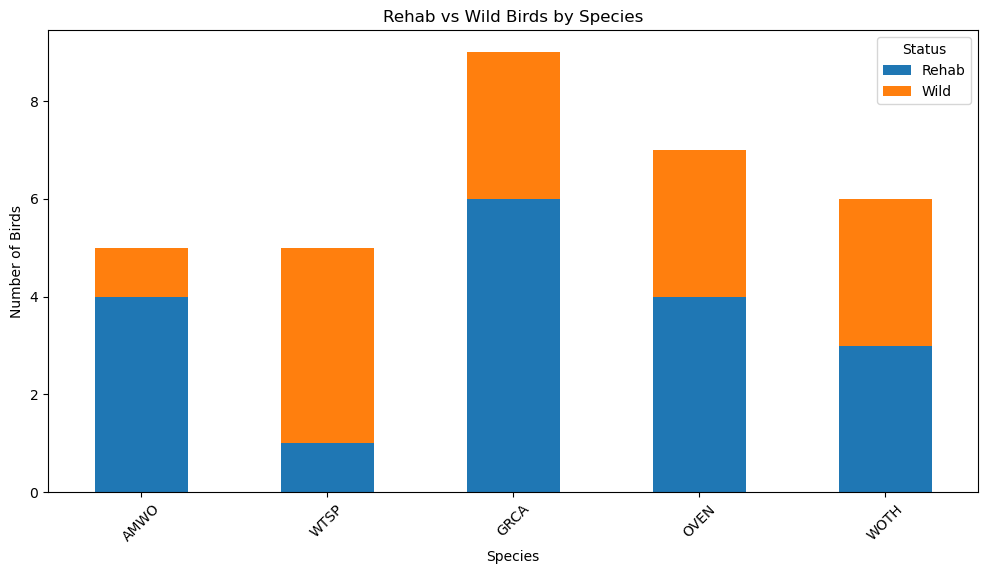

In [19]:
plot_rehab_summary(df_detections)

<module 'matplotlib.pyplot' from '/Users/km7yh/miniconda3/envs/gis_dev/lib/python3.11/site-packages/matplotlib/pyplot.py'>

<Figure size 1500x600 with 0 Axes>

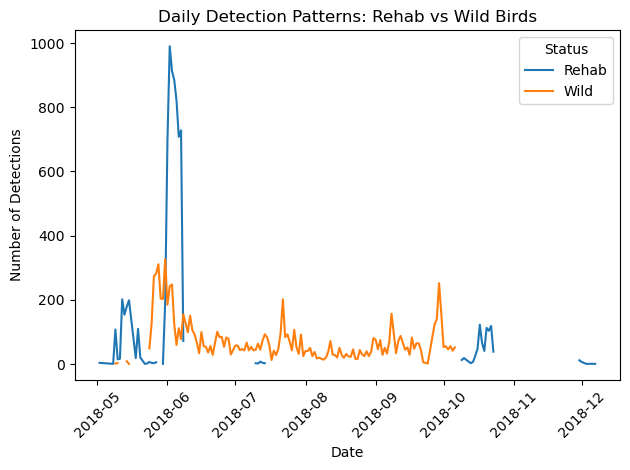

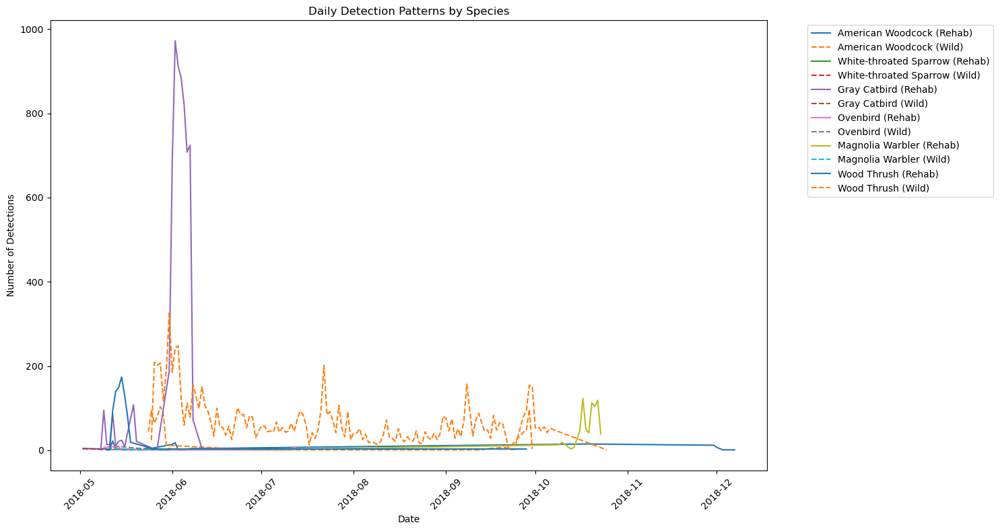

In [20]:
# using custom functions - plot detection patterns overall and by species
plot_overall_detection_patterns(df_detections)
plot_species_detection_patterns(df_detections)

### Detection Patterns Key Observations:
1.	**Species Detection Peaks**: The highest peak is seen for the Ovenbird (Rehab) in early June, reaching nearly 1,000 detections. The Ovenbird (Wild) also shows a high detection rate around the same time but at a lower intensity.
2.	**Species with Lower Detections**: Other species like the American Woodcock, White-throated Sparrow, Gray Catbird, Magnolia Warbler, and Wood Thrush have relatively lower and more sporadic detection patterns throughout the year. Their peaks are considerably lower than the Ovenbird detections.
3.	**Seasonal Patterns**: There appears to be a seasonal trend where bird detections, especially for Ovenbird species, spike in early summer and decrease significantly afterward, with some smaller fluctuations seen in the fall.

## 2. Spatial Analysis
- What are the movement patterns?
    - Geographic distribution of detections
    - Range/territory size analysis using MovingPandas
        - Calculate trajectory lengths
        - Measure movement speeds
        - Analyze stop/rest locations
    - Movement corridors identification
        - Trajectory clustering
        - Common path analysis

Using the [MovingPandas](https://movingpandas.org/) library, we can analyze the movement patterns of the birds by creating trajectory data structures. 

Built on top of GeoPandas and Pandas, this library provides a robust framework for trajectory analysis using the time-series data we already have from Motus.

According to its documentation, _MovingPandas follows the **trajectories = timeseries with geometries** approach of modeling movement data._

I think of trajectories as a series of connected points in space and time. Adding them to the dataframe as a GeoDataFrame with a geometry column makes them easier to work with.


In [21]:
# Create trajectory data structure from detections dataframe using MovingPandas
mpd_traj = create_mpd_traj(df_detections)
print(f"Trajectory Type: {type(mpd_traj)}")

# Get movement statistics
mpd_traj_stats = create_traj_stats(mpd_traj)
display(mpd_traj_stats)

# further summarize trajectory statistics
summaries = create_traj_summaries(mpd_traj_stats)

Trajectory Type: <class 'movingpandas.trajectory_collection.TrajectoryCollection'>


,tag_id,species,rehab_status,duration_hours,length_km,avg_speed_kmh
0,24345,Ovenbird,Y,86.592500,1946.312371,22.476685
1,24376,Gray Catbird,N,0.284722,10.167210,35.709227
2,28413,Magnolia Warbler,N,97.042778,524.176398,5.401498
3,28414,White-throated Sparrow,N,2.795000,246.577979,88.221101
4,28415,Magnolia Warbler,Y,344.381389,0.000000,0.000000
5,28416,White-throated Sparrow,N,0.001389,0.000000,0.000000
6,28419,Magnolia Warbler,Y,0.216944,0.000000,0.000000
7,28420,American Woodcock,Y,141.028889,0.000000,0.000000
8,28422,Gray Catbird,Y,20.001389,0.000000,0.000000
9,28423,White-throated Sparrow,Y,3.750833,178.202314,47.510059


In [22]:
# by overall, then by rehab status and species
print("Overall Summary by Rehab Status:")
print(summaries['overall_summary'])

Overall Summary by Rehab Status:
             duration_hours                                 length_km          \
                      count    mean      std   min      max     count    mean   
rehab_status                                                                    
N                        13  783.60  1393.28  0.00  3686.14        13  158.34   
Y                        19  567.77  1143.10  0.22  4058.61        19  301.25   

                                   avg_speed_kmh                            
                 std  min      max         count   mean    std  min    max  
rehab_status                                                                
N             306.41  0.0  1050.64            13  17.75  28.58  0.0  88.22  
Y             499.64  0.0  1946.31            19   6.45  13.61  0.0  47.51  


In [23]:
print("\nTrajectory Counts by Species:")
print(summaries['trajectory_counts'])


Trajectory Counts by Species:
                        Wild  Rehab  Total
species                                   
American Woodcock          1      4      5
Gray Catbird               3      6      9
Magnolia Warbler           1      3      4
Ovenbird                   2      2      4
White-throated Sparrow     3      1      4
Wood Thrush                3      3      6


In [24]:
print("\nDetailed Species Summary:")
print(summaries['species_summary'])


Detailed Species Summary:
                                    duration_hours                             \
                                             count     mean      std      min   
species                rehab_status                                             
American Woodcock      N                         1  3686.14      NaN  3686.14   
                       Y                         4  1161.34  1932.37   141.03   
Gray Catbird           N                         3    25.14    42.50     0.28   
                       Y                         6   343.85   443.32    17.29   
Magnolia Warbler       N                         1    97.04      NaN    97.04   
                       Y                         3   121.63   193.17     0.22   
Ovenbird               N                         2   203.60   287.84     0.07   
                       Y                         2    46.34    56.93     6.09   
White-throated Sparrow N                         3     1.37     1.40     0.00   
 

###  Geographic distribution of detections
The Motus detection dataset originates from the Motus Northeast Collaboration network. Plotting the receiver locations and the detected bird movements on a map can help us visualize the coverage and detectability of the network.

The northeast region of the US is covered by 37 receivers (as of Q4 2019), as shown in the maps below.  

In [25]:
# print number of receivers
print(f"Number of receivers: {len(df_detections['recvDeployName'].unique())}")

Number of receivers: 37


Receivers are color-coded by the number of detections they have recorded in total.

In [26]:
m = plot_receivers_map(df_detections)
display(m)

## Plotting Trajectories
Simple trajectories can be plotted with Matplotlib using with each bird's tag ID, using the MovingPandas TrajectoryCollection object.
From the base dataset this dataset is just a series of points with a location and timestamp, so this plot gives a quick representation of the detected bird movements as lines as well.
MovingPandas has a number of additional functionalities for smoothing or otherwise interpolating the trajectories (my custom function is not one of them).


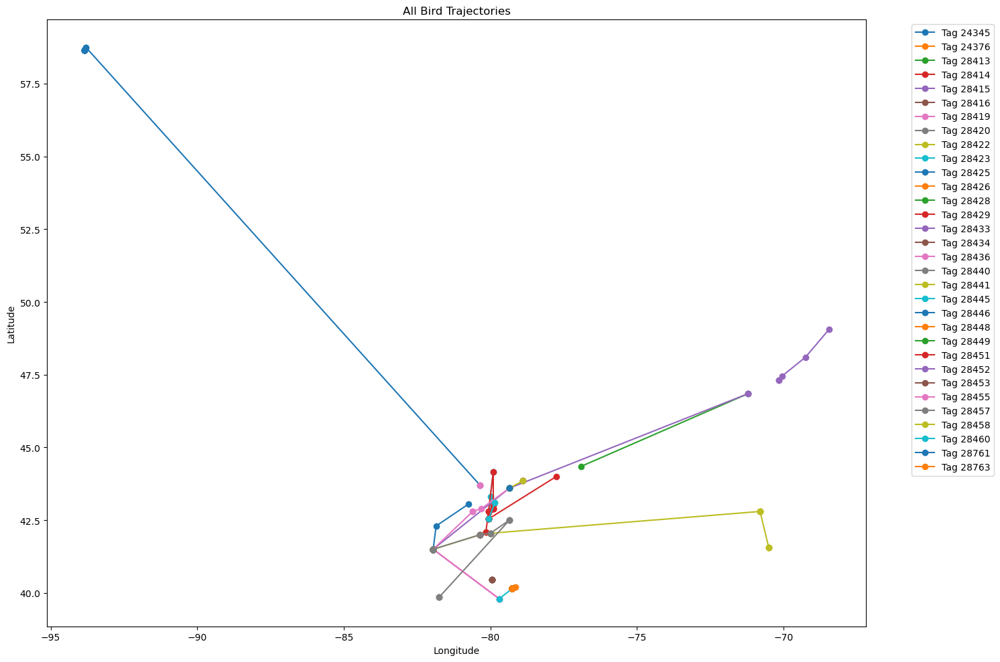

In [27]:
# plot simple trajectories with matplotlib
fig = plot_simple_trajectories(mpd_traj, "All Bird Trajectories")
plt.show()

Plotting the detected bird movements on a map can help us visualize the coverage and detectability of the network.

From the Folium map below, we can see that the birds were detected in a number of locations across the northeast region of the US and southern Ontario on both sides of Lake Erie and Lake Ontario.

In [28]:
m = plot_bird_movements(mpd_traj)
display(m)

In [29]:
# plot interactive trajectories
m = plot_interactive_trajectories(mpd_traj)
display(m)


In [30]:
# Use both functions
# print("Creating Folium map...")
m_folium  = plot_animated_trajectories_folium(mpd_traj)

In [31]:
# Create and display maps
create_and_display_species_maps(df_detections)


White-throated Sparrow



American Woodcock



Gray Catbird



Ovenbird



Wood Thrush



Magnolia Warbler


### Challenges

While conducting this analysis, several challenges were encountered that may impact the interpretation of results:
1. Limited Sample Size
    - The dataset included a relatively small number of birds, which poses significant limitations for drawing broad conclusions. 
    - **Species Diversity**: The limited number of species represented in the sample may not accurately reflect the overall diversity of the bird population in the study area. This could lead to an underestimation of the ecological richness and the potential impacts of environmental changes on various species.
    - **Unique Birds Detected**: The small sample size also means that the number of unique individuals detected was low. This raises concerns about the representativeness of the data and may highlight striking declines in bird populations that are already occurring. 
        - For instance, if only a few individuals of a species are detected, it may indicate that the population is at risk or declining, which could be a critical signal for conservation efforts.
    
2. Implications for Conservation
    - The findings from this limited dataset should be interpreted with caution. While they may suggest trends or patterns, they may not provide a complete picture of the bird populations in the area.
    - Future studies should aim to increase sample sizes and include a broader range of species to better understand population dynamics and inform effective conservation strategies.

Addressing these challenges is crucial for ensuring that the insights gained from this analysis contribute meaningfully to our understanding of avian ecology and the urgent need for conservation efforts in the face of declining bird populations.

### Future Research Opportunities

While this current workbook focuses on Population Demographics and Spatial Analysis, there are several other valuable analyses that could be conducted with this ecological data. Below are some suggested topics for future exploration:

- Detection Network Analysis
- **Receiver Effectiveness**: Assess the performance of the receiver network in detecting birds.
    - **Coverage Analysis**: Map the geographical distribution of receivers and identify gaps in coverage.
    - **Detection Frequency**: Analyze the number of detections per receiver to determine which receivers are most effective.
    - **Temporal Patterns**: Investigate how detection rates vary over time, identifying peak detection periods and potential seasonal trends.

- Comparative Analysis
- **Behavioral Comparisons**: Examine differences in movement and behavior between rehab and wild birds.
    - **Movement Patterns**: Compare trajectory characteristics, such as speed and distance traveled, to understand how rehabilitation affects bird behavior.
    - **Survival and Detection Rates**: Analyze the survival rates of rehab birds versus wild birds, including how often they are detected over time.
    - **Territory Size**: Calculate and compare home ranges of rehab and wild birds to assess habitat use and territorial behavior.
    - **Seasonal Behavior Patterns**: Explore how movement and detection patterns change with the seasons, providing insights into migratory behavior and habitat preferences.

These analyses can provide deeper insights into the ecological dynamics of bird populations, the effectiveness of rehabilitation efforts, and the role of environmental factors in shaping bird behavior. Future work could expand on these themes to enhance our understanding of avian ecology and inform conservation strategies.

# Questions?
Feel free to reach out to me by email with any questions or comments!

[Keon Monroe](mailto:keon.monroe@gmail.com)